In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from cycler import cycler
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
import numpy as np
import scipy.stats as sps
import json, pickle, os, corner, glob, sys
import enterprise.signals.utils as utils
from enterprise.pulsar import Pulsar
import arviz as az
from collections import defaultdict
import pandas as pd


import warnings
warnings.filterwarnings('ignore')

In [3]:
import la_forge.diagnostics as dg
import la_forge.core as co
from la_forge.rednoise import plot_rednoise_spectrum, plot_free_spec
from la_forge.utils import epoch_ave_resid

In [4]:
color_cycle_wong = ['#000000','#E69F00','#009E73','#56B4E9','#0072B2','#F0E442','#D55E00','#CC79A7']
mpl.rcParams['axes.prop_cycle'] = cycler(color=color_cycle_wong)

In [5]:
current_path = os.getcwd()
splt_path = current_path.split("/")
top_path_idx = splt_path.index("akaiser")
#top_path_idx = splt_path.index("nanograv")
top_dir = "/".join(splt_path[0 : top_path_idx + 1])

In [6]:
e_e_path = top_dir + "/enterprise_extensions/"
sys.path.insert(0, e_e_path)
from enterprise_extensions.timing_2 import get_astrometric_priors
import nltm_plot_utils_v2 as nltm

In [7]:
psr_name = 'J1744-1134'#'J1640+2224'#'J2317+1439' 'J1909-3744'

psrlist = [psr_name]
datareleases = ['5yr','9yr','11yr','12p5yr']

psrs = nltm.get_psrs(psrlist,datareleases)
pardict = nltm.get_pardict(psrs,datareleases)

5yr
9yr
11yr
12p5yr


In [8]:
for psr,dataset in zip(psrs,datareleases):
    print(dataset)
    for par,vals,errs in zip(psr.fitpars[1:],psr.t2pulsar.vals(),psr.t2pulsar.errs()):
        if "DMX" in ["".join(list(x)[0:3]) for x in par.split("_")][0]:
            pass
        elif "FD" in ["".join(list(x)[0:2]) for x in par.split("_")][0]:
            pass
        elif "JUMP" in ["".join(list(x)[0:4]) for x in par.split("_")][0]:
            pass
        elif par in ["Offset","TASC"]:
            pass
        elif par in ["RAJ", "DECJ", "ELONG", "ELAT", "BETA", "LAMBDA"]:
            pass
        #elif par in ["PMRA", "PMDEC", "PMELONG", "PMELAT", "PMBETA", "PMLAMBDA"]:
        #    pass
        else:
            print(' ',par)
            print('   ',vals,errs)

5yr
  F0
    245.42612370746805495 7.8120329600000003606e-12
  F1
    -5.380861803716761007e-16 2.4292051697256330384e-20
  PMRA
    18.674102128897537591 0.058189231312464145818
  PMDEC
    -10.149834842581100052 0.17635164382271092953
  PX
    2.9394204306866547963 0.31742874353702948964
9yr
  F0
    245.4261234998366774 2.705000000000000086e-13
  F1
    -5.381245662772e-16 4.7644641180109996765e-21
  PMELONG
    19.0095 0.016099999999999999728
  PMELAT
    -8.6834 0.07760000000000000231
  PX
    2.4467 0.12130000000000000504
11yr
  F0
    245.4261234816102046 2.3099999999999997496e-13
  F1
    -5.381249770587e-16 3.1687107982579998233e-21
  PMELONG
    19.0438 0.012399999999999999564
  PMELAT
    -8.7658 0.06189999999999999669
  PX
    2.2906 0.11189999999999999947
12p5yr
  F0
    245.4261234687297986 1.7756000000000000274e-12
  F1
    -5.381120867392e-16 1.67559595368100003e-20
  PMELONG
    19.0467 0.010800000000000000572
  PMELAT
    -8.863 0.05609999999999999709
  PX
    2.3799 

In [9]:
chaindir_list = []
#indices = np.arange(1,6,1)
indices = [1,2]
ephems = ['DE436','DE438','DE405','DE421']
#big_chaindir = os.getcwd()+'/chains/{}_all_var'.format(psr)
for i in indices:
    for datarelease in datareleases:
        if i == 1:
            if datarelease != '12p5yr':
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_uniform_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
                chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_bounded_normal_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_DE436_nltm_ltm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_DE436_nltm_{}'.format(psr_name,datarelease,psr_name,i))
        elif i == 2:
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_uniform_DE436_nltm_ltm_{}'.format(psr_name,datarelease,psr_name,i))
        """
        #chaindir_list.append(os.getcwd()+'/chains/{}/{}_all_var_{}'.format(datarelease,psr,i))
        if datarelease in ['5yr','9yr'] and i in [3,4] :
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_uniform_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_bounded_normal_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
        elif datarelease in ['11yr'] and i in [1,2]:
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_uniform_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
            chaindir_list.append(os.getcwd()+'/{}/chains/{}/{}_testing_bounded_normal_RV_True_WV_True_tm_{}'.format(psr_name,datarelease,psr_name,i))
        """
[print(chaindir) for chaindir in chaindir_list];

/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/5yr/J1744-1134_testing_uniform_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/5yr/J1744-1134_testing_bounded_normal_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/5yr/J1744-1134_uniform_DE436_nltm_ltm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/5yr/J1744-1134_uniform_DE436_nltm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/9yr/J1744-1134_testing_uniform_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/9yr/J1744-1134_testing_bounded_normal_RV_True_WV_True_tm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/9yr/J1744-1134_uniform_DE436_nltm_ltm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/9yr/J1744-1134_uniform_DE436_nltm_1
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/11yr/J1744-1134_testing_uniform_RV_True_WV_True_tm_1
/hyrul

In [10]:
chain_dict = nltm.get_chain_tmparam_dict(chaindir_list)

5yr J1744-1134_testing_uniform_RV_True_WV_True_tm_1 Loaded.      
5yr J1744-1134_testing_bounded_normal_RV_True_WV_True_tm_1 Loaded.      
5yr J1744-1134_uniform_DE436_nltm_ltm_1 Loaded.      
5yr J1744-1134_uniform_DE436_nltm_1 Loaded.      
9yr J1744-1134_testing_uniform_RV_True_WV_True_tm_1 Loaded.      
9yr J1744-1134_testing_bounded_normal_RV_True_WV_True_tm_1 Loaded.      
9yr J1744-1134_uniform_DE436_nltm_ltm_1 Loaded.      
9yr J1744-1134_uniform_DE436_nltm_1 Loaded.      
11yr J1744-1134_testing_uniform_RV_True_WV_True_tm_1 Loaded.      
11yr J1744-1134_testing_bounded_normal_RV_True_WV_True_tm_1 Loaded.      
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/11yr/J1744-1134_uniform_DE436_nltm_ltm_1/chain_1.0992583333970931.txt cant be loaded.
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/11yr/J1744-1134_uniform_DE436_nltm_ltm_1/chain_1.2083688835429547.txt cant be loaded.
/hyrule/data/users/akaiser/enterprise_timing/J1744-1134/chains/11yr/J1744-1

In [11]:
for p in chain_dict.keys():
    print(p)
    for px_p in chain_dict[p].keys():
        print('  ',px_p)
        for dset in chain_dict[p][px_p].keys():
            print('    ',dset)
            for subset in chain_dict[p][px_p][dset]['chains']:
                print('      ',np.shape(subset))
print('')
print('')
print(pardict.keys())
print(pardict['9yr']['{}'.format(psrlist[0])].keys())

uniform
   parfile_priors
     5yr
       (149925, 16)
     9yr
       (149925, 22)
     11yr
       (149925, 22)
   parfile_priors_DE436
     5yr
       (16725, 16)
       (18525, 16)
       (9150, 16)
     9yr
       (5625, 22)
       (6450, 22)
       (2925, 22)
     11yr
       (49425, 22)
       (50700, 22)
       (4575, 22)
     12p5yr
       (3675, 22)
       (5250, 22)
       (2100, 22)
bounded
   parfile_priors
     5yr
       (149925, 16)
     9yr
       (149925, 22)
     11yr
       (149925, 22)


dict_keys(['5yr', '9yr', '11yr', '12p5yr'])
dict_keys(['F0', 'F1', 'PMELONG', 'PMELAT', 'PX'])


In [12]:
trimmed_chain_dict = nltm.get_trimmed_chain_tmparam_dict(chain_dict)

In [13]:
for p in trimmed_chain_dict.keys():
    print(p)
    for px_p in trimmed_chain_dict[p].keys():
        print('  ',px_p)
        for dset in trimmed_chain_dict[p][px_p].keys():
            print('    ',dset)
            for subset in trimmed_chain_dict[p][px_p][dset]['chains']:
                print('      ',np.shape(subset))

uniform
   parfile_priors
     5yr
       (2100, 16)
     9yr
       (2100, 22)
     11yr
       (2100, 22)
   parfile_priors_DE436
     5yr
       (2100, 16)
       (2100, 16)
       (2100, 16)
     9yr
       (2100, 22)
       (2100, 22)
       (2100, 22)
     11yr
       (2100, 22)
       (2100, 22)
       (2100, 22)
     12p5yr
       (2100, 22)
       (2100, 22)
       (2100, 22)
bounded
   parfile_priors
     5yr
       (2100, 16)
     9yr
       (2100, 22)
     11yr
       (2100, 22)


# Make a List of `la_forge` Cores

In [14]:
core_list = []
for chaindir in chaindir_list:
    core_list.append(co.Core(label='_'.join(chaindir.split('/')[-2:]), chaindir=chaindir))

Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 49975
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 49975
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 5575
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Plea

In [15]:
standard_chain = pd.read_csv(os.getcwd()+'/standard_runs/chain_1.txt', sep='\t', dtype=float, header=None).values
par_names = ['J1744-1134_Rcvr1_2_GASP_efac','J1744-1134_Rcvr1_2_GASP_log10_ecorr',
             'J1744-1134_Rcvr1_2_GASP_log10_equad','J1744-1134_Rcvr1_2_GUPPI_efac',
             'J1744-1134_Rcvr1_2_GUPPI_log10_ecorr', 'J1744-1134_Rcvr1_2_GUPPI_log10_equad',
             'J1744-1134_Rcvr_800_GASP_efac', 'J1744-1134_Rcvr_800_GASP_log10_ecorr',
             'J1744-1134_Rcvr_800_GASP_log10_equad', 'J1744-1134_Rcvr_800_GUPPI_efac',
             'J1744-1134_Rcvr_800_GUPPI_log10_ecorr', 'J1744-1134_Rcvr_800_GUPPI_log10_equad',
             'J1744-1134_red_noise_gamma', 'J1744-1134_red_noise_log10_A',
             'lnlike', 'lnprior', 'chain_accept', 'pt_chain_accept']
standard_cores = co.Core(label='standard runs',chain = standard_chain,params=par_names)

Appending PTMCMCSampler sampling parameters to end of parameter list.
If unwanted please provide a parameter list.
No burn specified. Burn set to 25% of chain length, 2500
You may change the burn length with core.set_burn()
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [16]:
dset = '11yr'
por = 'uniform'
px_por = 'parfile_priors'
tmp_chaindir_indices = nltm.get_chaindir_indices(chaindir_list)
print(tmp_chaindir_indices.keys())
print(tmp_chaindir_indices[por].keys())
print(tmp_chaindir_indices[por][px_por].keys())

dict_keys(['uniform', 'bounded'])
dict_keys(['parfile_priors', 'parfile_priors_DE436'])
dict_keys(['5yr', '9yr', '11yr'])


In [17]:
dset = '11yr'
por = 'uniform'
px_por = 'parfile_priors_DE436'
tmp_core_list = [core_list[x] for x in tmp_chaindir_indices[por][px_por][dset]]
tmp_core_labels = [core_list[x].label for x in tmp_chaindir_indices[por][px_por][dset]]
tmp_core_list.append(standard_cores)
tmp_core_labels.append('standard runs')
tmp_core_common_pars = []
tmp_core_tm_pars = []
for core in tmp_core_list:
    if len(tmp_core_common_pars)==0:
        for core_param in core.params:
            if core_param not in ['lnlike','lnprior', 'chain_accept', 'pt_chain_accept', 'chain accept', 'pt chain accept']:
                tmp_core_common_pars.append(core_param)
            if 'timing' in core_param.split('_'):
                tmp_core_tm_pars.append(core_param)
    else:
        noncommon_pars = []
        for com_param in tmp_core_common_pars:
            if com_param not in core.params:
                noncommon_pars.append(com_param)
        for ncom_param in noncommon_pars:
            del tmp_core_common_pars[tmp_core_common_pars.index(ncom_param)]

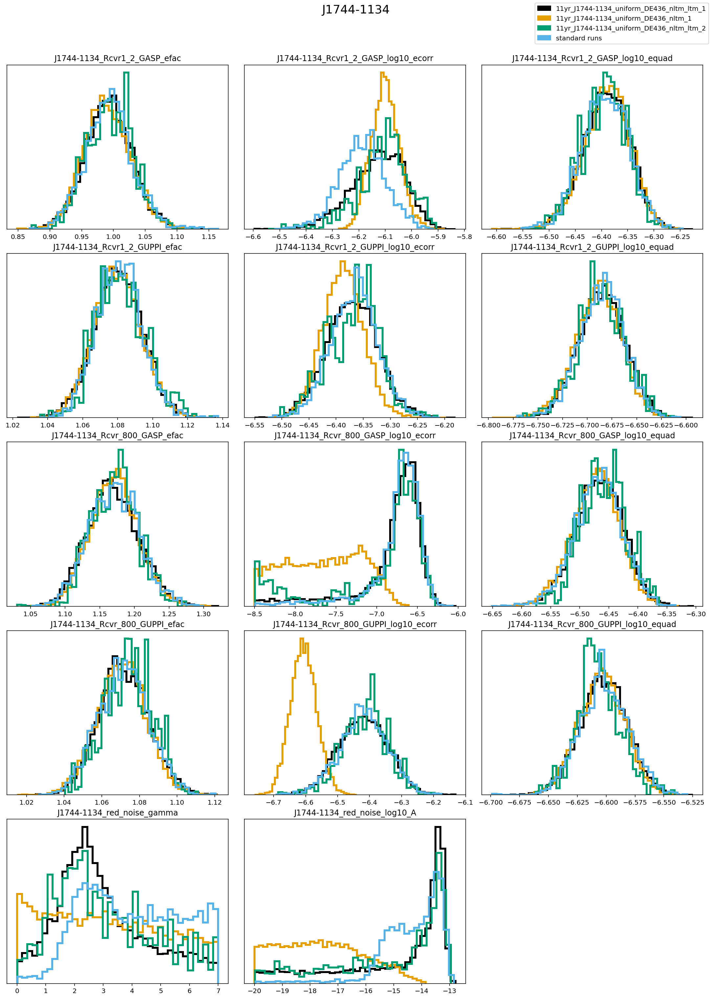

In [18]:
tmp_core_kwargs = {'hist':True, 'ncols':3, 'title_y':1.05,
                   'hist_kwargs':dict(fill=False),'linewidth':3.}
dg.plot_chains(tmp_core_list,
               suptitle=psr_name,
               legend_labels=tmp_core_labels,
               pars = tmp_core_common_pars,
               **tmp_core_kwargs)
#,save='Figures/J1744_Noise_comp.png')

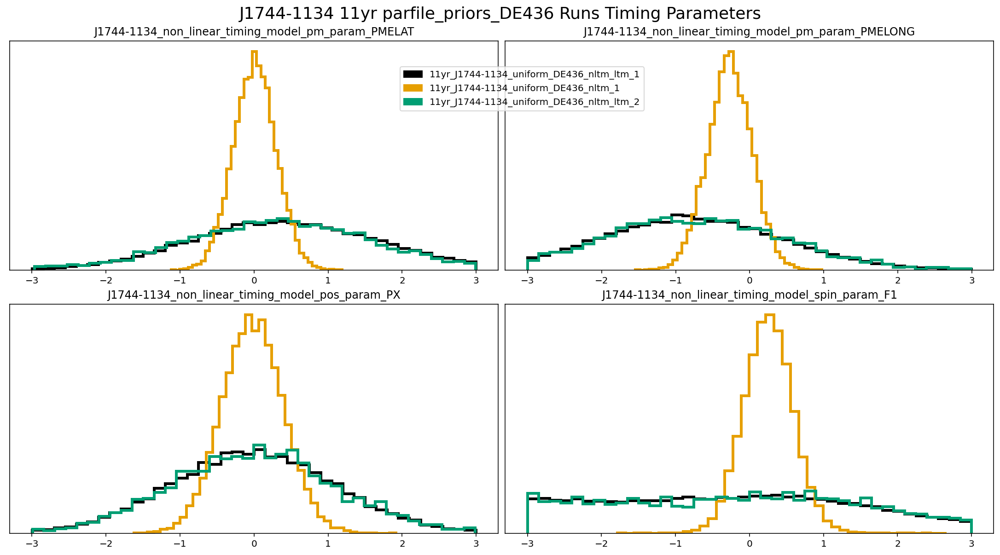

In [19]:
dataset='11yr'
priors = ['uniform']
px_priors = ['parfile_priors_DE436']
dg.plot_chains(tmp_core_list[:-1],
               suptitle='{} {} {} Runs Timing Parameters'.format(psrlist[0],dataset,px_priors[0]),
               legend_labels=tmp_core_labels[:-1],
               pars = tmp_core_tm_pars,linewidth=3.,
               title_y=1.03,legend_loc=(.4,.8),ncols=2)
#,save='Figures/J1744_tm_comp.png')

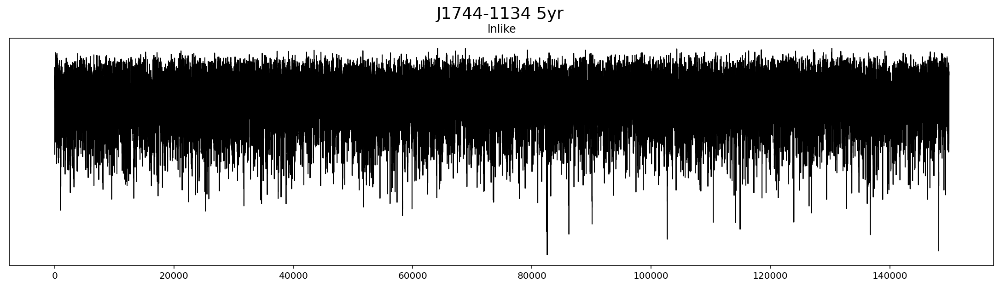

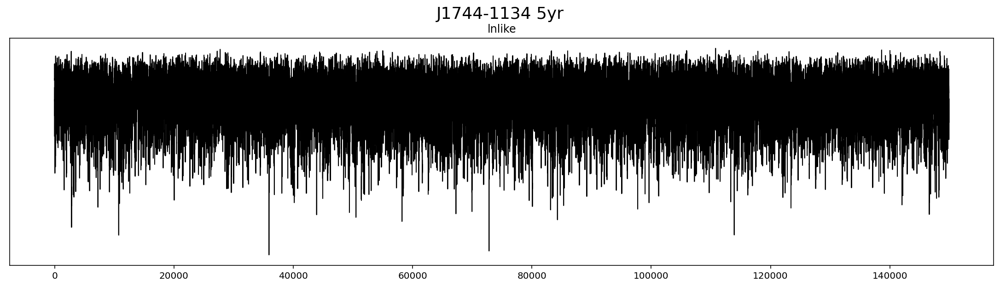

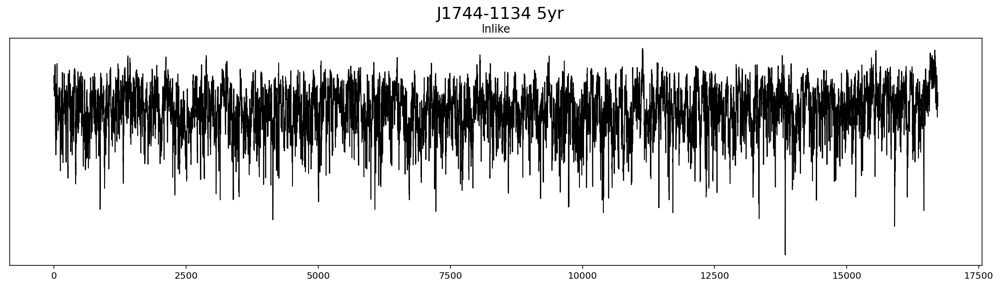

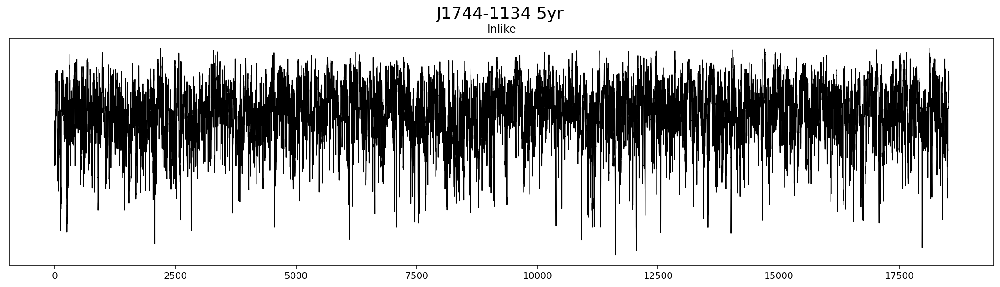

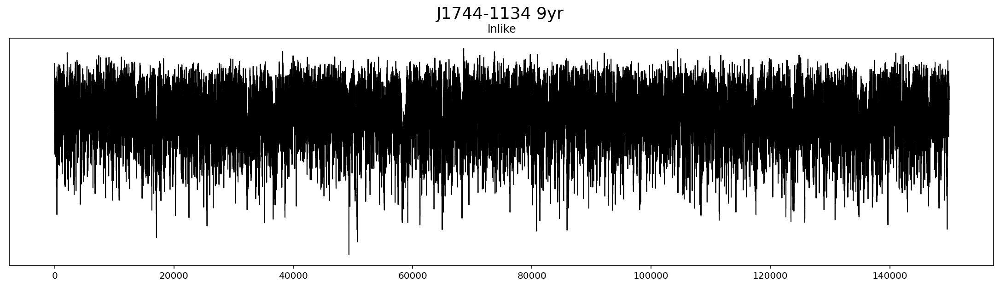

...

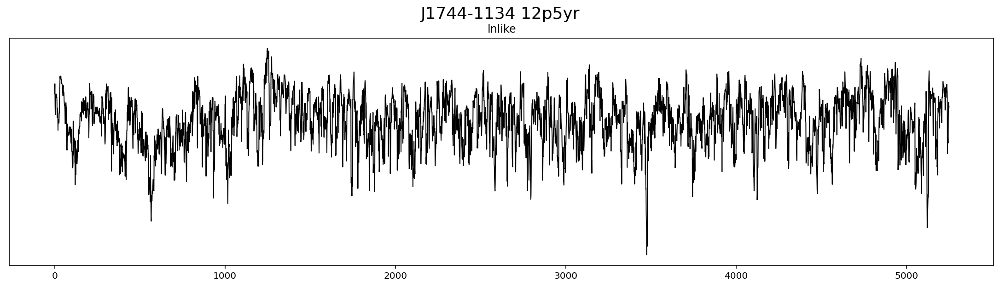

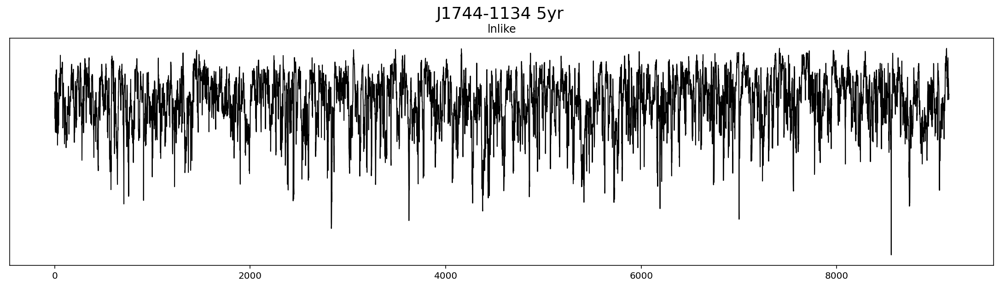

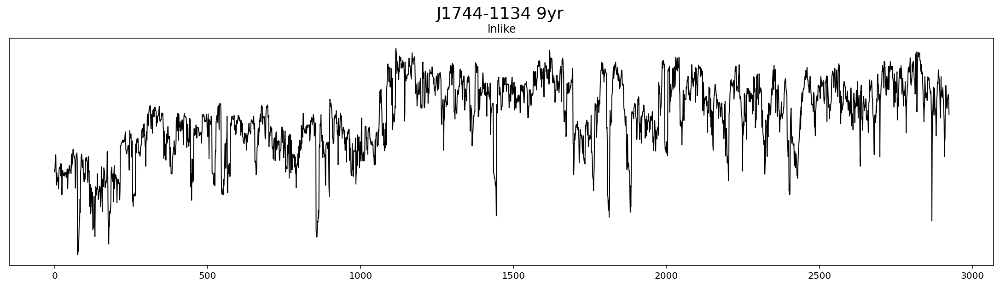

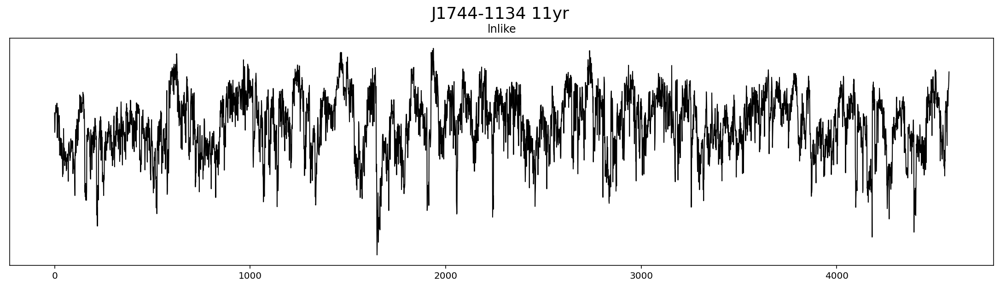

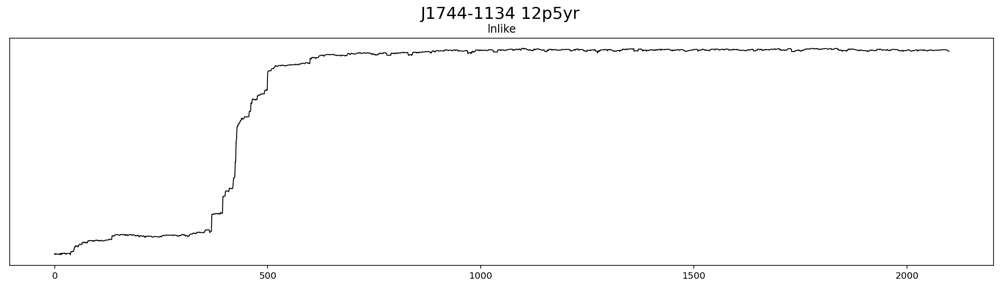

In [20]:
for tmp_core,tmp_chaindir in zip(core_list,chaindir_list):
    dg.plot_chains(tmp_core,pars=['lnlike'],hist=False,
                   suptitle=tmp_chaindir.split('/')[-1].split('_')[0]+' '+tmp_chaindir.split('/')[-2],
                   ncols=1,title_y=1.05)

# Plot Cores with `la_forge`

In [21]:
def plt_selection_of_dataset(dataset,px_prior='all'):
    if px_prior == 'all':
        selection = ['vlbi','parfile']
    else:
        selection = [px_prior]

    core_kwargs = {'hist':True, 'ncols':3, 'title_y':1.07,
                   'suptitle':'{} {} {} Runs'.format(psrlist[0],dataset,px_prior),
                   'bins':10,'hist_kwargs':dict(fill=False),'linewidth':2.}
    misc_kwargs = {'legend_on':True,'legend_loc':(.7,0.05)}
    priors = []
    px_priors = []
    for p in chain_dict.keys():
        for px_p in chain_dict[p].keys():
            for select in selection:
                if select in px_p.split('_'):
                    if dataset in chain_dict[p][px_p].keys():
                        if p not in priors:
                            priors.append(p)
                        if px_p not in px_priors:
                            px_priors.append(px_p)
    if priors and px_priors:
        nltm.plot_common_chains(core_list,chaindir_list,priors,px_priors,dataset,
                                plot_kwargs=core_kwargs,misc_kwargs=misc_kwargs)
    else:
        print(selection,'not in',dataset)

## 5yr Cores

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


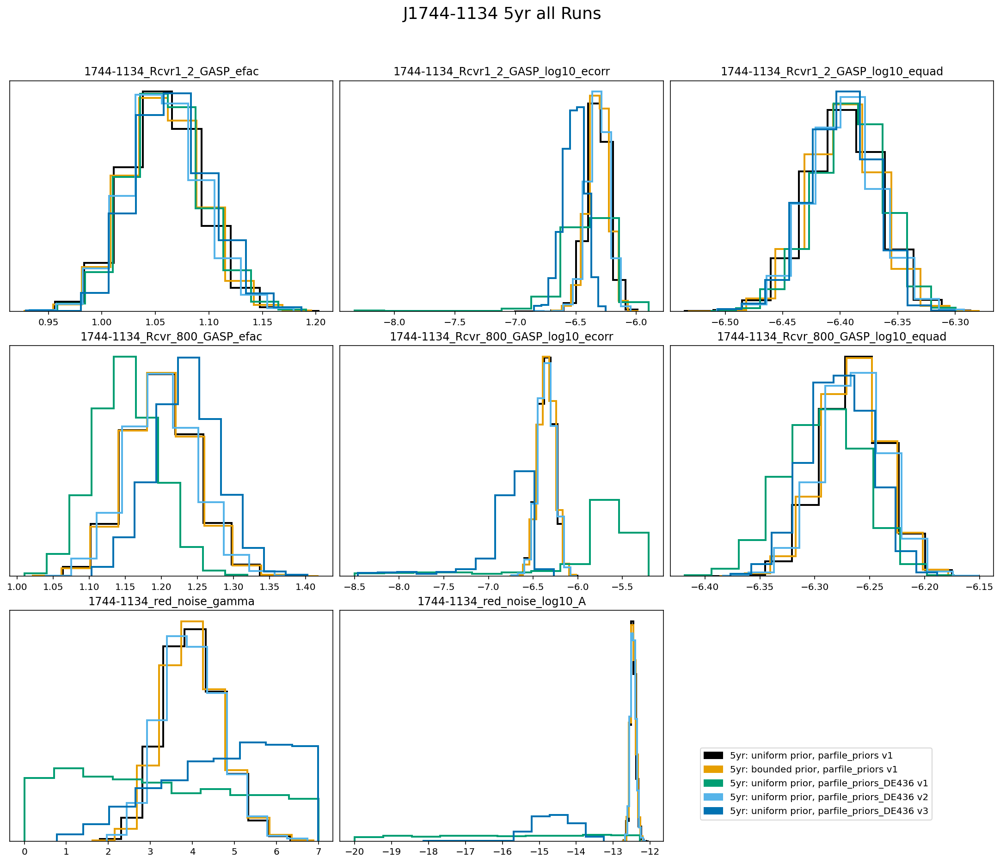

In [22]:
#All Runs
plt_selection_of_dataset('5yr')

## 9yr Cores

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


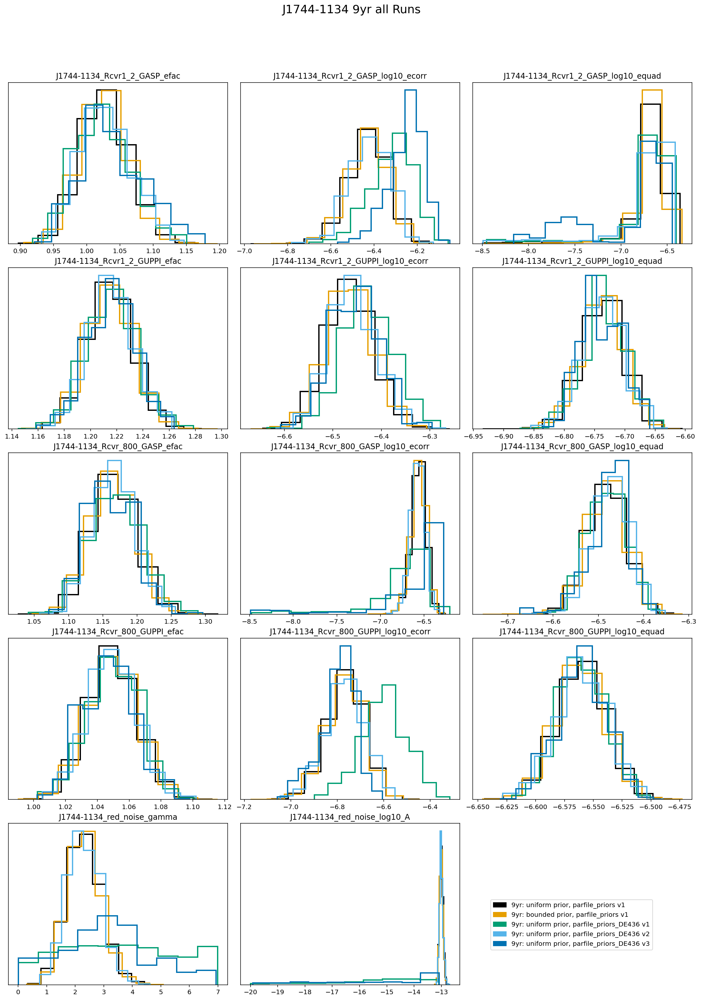

In [23]:
#All Runs
plt_selection_of_dataset('9yr')

## 11yr Cores

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


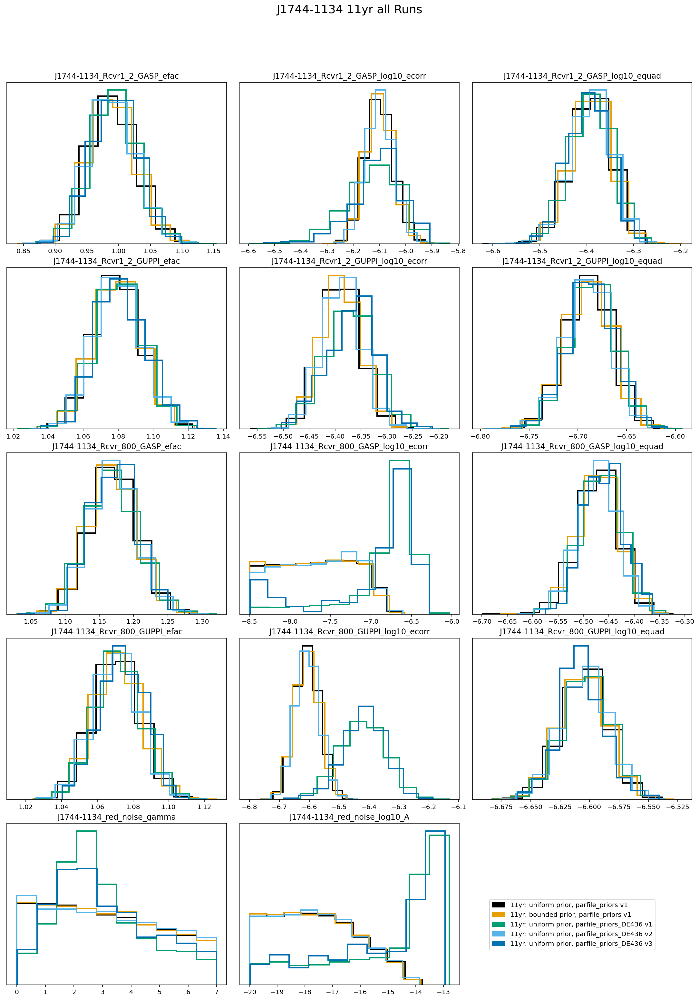

In [24]:
#All Runs
plt_selection_of_dataset('11yr')

## 12.5yr Cores

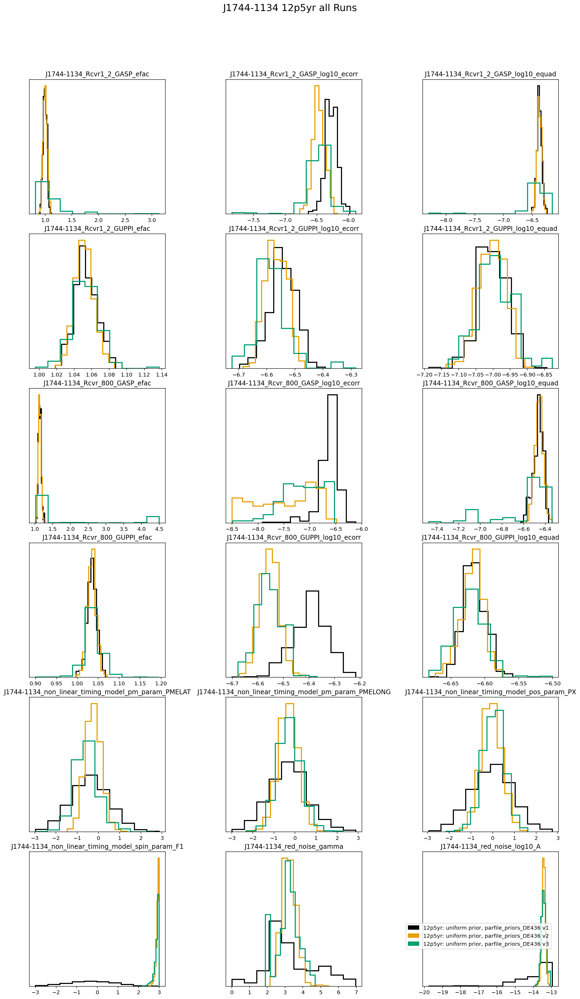

In [25]:
#All Runs
plt_selection_of_dataset('12p5yr')

# Do Plotting with `arviz`
Making `Arviz` dictionaries to plot all chains

In [26]:
az_comb,az_comb_chain_dict = nltm.get_combined_arviz_obj_from_dict(trimmed_chain_dict,psrs,return_dict=True)

(2100, 16)
(2100, 22)
(2100, 22)
(2100, 16)
(2100, 16)
(2100, 16)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 22)
(2100, 16)
(2100, 22)
(2100, 22)


In [27]:
#print(az_comb.posterior)

In [28]:
#az.summary(az_comb)

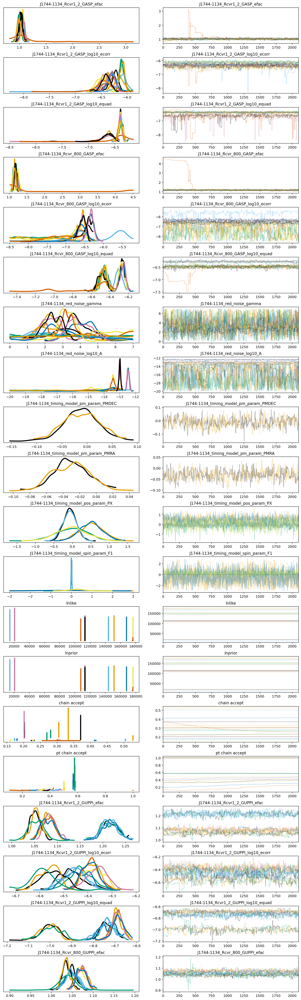

In [29]:
az.plot_trace(az_comb,plot_kwargs={'linewidth':3});

In [30]:
white_pars_all = []
parfile_priors_pars_all = []
for param in az_comb_chain_dict.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_all.append(param)
        else:
            parfile_priors_pars_all.append(param)

White noise parameters

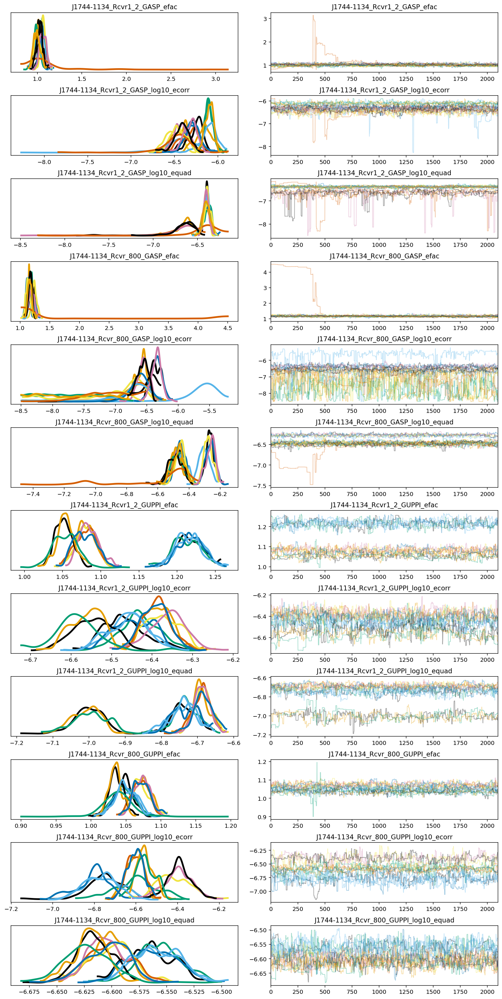

In [31]:
az.plot_trace(az_comb,var_names=white_pars_all,plot_kwargs={'linewidth':3});

Red + Timing Parameters

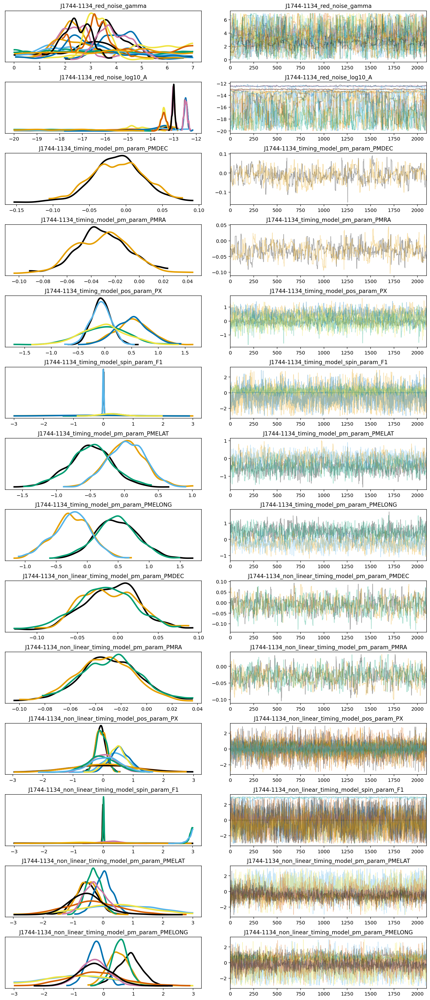

In [32]:
az.plot_trace(az_comb,var_names=parfile_priors_pars_all,plot_kwargs={'linewidth':3});

# Rescaling the timing parameters to their physical values to properly compare datasets

Have to split into datasets for variable WN
Have to separate by number of parameters, then join

In [33]:
rescaled_5yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'5yr')
az_comb_5yr_rescaled = az.convert_to_inference_data(rescaled_5yr_chain_dict_comb)

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


In [34]:
print(np.shape(rescaled_5yr_chain_dict_comb['lnprior']))

(5, 2100)


In [35]:
rescaled_5yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_5yr_chain_dict_comb,psr_name)
five_yr_chaindirs = []
for chaindir in chaindir_list:
    if '5yr' in chaindir.split('/'):
        five_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [36]:
rescaled_9yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'9yr')
az_comb_9yr_rescaled = az.convert_to_inference_data(rescaled_9yr_chain_dict_comb)

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


In [37]:
rescaled_9yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_9yr_chain_dict_comb,psr_name)
nine_yr_chaindirs = []
for chaindir in chaindir_list:
    if '9yr' in chaindir.split('/'):
        nine_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [38]:
rescaled_11yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'11yr')
az_comb_11yr_rescaled = az.convert_to_inference_data(rescaled_11yr_chain_dict_comb)

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


In [39]:
rescaled_11yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_11yr_chain_dict_comb,psr_name)
eleven_yr_chaindirs = []
for chaindir in chaindir_list:
    if '11yr' in chaindir.split('/'):
        eleven_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


In [40]:
rescaled_12p5yr_chain_dict_comb = nltm.get_combined_rescaled_chain_dict(trimmed_chain_dict,pardict,'12p5yr')
az_comb_12p5yr_rescaled = az.convert_to_inference_data(rescaled_12p5yr_chain_dict_comb)

12p5yr not in uniform parfile_priors dict_keys(['5yr', '9yr', '11yr'])
12p5yr not in bounded parfile_priors dict_keys(['5yr', '9yr', '11yr'])


In [41]:
rescaled_12p5yr_core_list_comb = nltm.get_rescaled_chains_as_core_list(rescaled_12p5yr_chain_dict_comb,psr_name)
twelvep5_yr_chaindirs = []
for chaindir in chaindir_list:
    if '12p5yr' in chaindir.split('/'):
        twelvep5_yr_chaindirs.append(chaindir)

Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.
Red noise frequencies must be set before plotting most red noise figures.
Please use core.set_rn_freqs() to set, if needed.


Combine the common parameters for the not donked up datasets

In [42]:
rescaled_chain_dict_all = {}
for param in rescaled_5yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param in rescaled_9yr_chain_dict_comb.keys():
            if param in rescaled_chain_dict_all.keys():
                rescaled_chain_dict_all[param] = np.concatenate((rescaled_chain_dict_all[param],
                                                                 rescaled_9yr_chain_dict_comb[param]),axis=0)
            else:
                rescaled_chain_dict_all[param] = np.concatenate((rescaled_5yr_chain_dict_comb[param],
                                                                 rescaled_9yr_chain_dict_comb[param]),axis=0)
        if param in rescaled_11yr_chain_dict_comb.keys():
            if param in rescaled_chain_dict_all.keys():
                rescaled_chain_dict_all[param] = np.concatenate((rescaled_chain_dict_all[param],
                                                                 rescaled_11yr_chain_dict_comb[param]),axis=0)
            else:
                rescaled_chain_dict_all[param] = np.concatenate((rescaled_5yr_chain_dict_comb[param],
                                                                  rescaled_11yr_chain_dict_comb[param]),axis=0)
        if param in rescaled_12p5yr_chain_dict_comb.keys():
            if param in rescaled_chain_dict_all.keys():
                rescaled_chain_dict_all[param] = np.concatenate((rescaled_chain_dict_all[param],
                                                                 rescaled_12p5yr_chain_dict_comb[param]),axis=0)
            else:
                rescaled_chain_dict_all[param] = np.concatenate((rescaled_5yr_chain_dict_comb[param],
                                                                  rescaled_12p5yr_chain_dict_comb[param]),axis=0)

In [43]:
#az.summary(az_comb_5yr_rescaled)

In [44]:
#az.summary(az_comb_9yr_rescaled)

In [45]:
def plt_all_rescaled_dataset(core_list,chaindir_list,dataset):
    core_kwargs = {'hist':True, 'ncols':4, 'title_y':1.03,
               'suptitle':'{} {} All Runs'.format(psrlist[0],dataset),
               'bins':10,'hist_kwargs':dict(fill=False),'linewidth':2.}
    misc_kwargs = {'legend_on':True,'legend_loc':(.7,0.05)}
    priors = []
    px_priors = []
    for p in chain_dict.keys():
        for px_p in chain_dict[p].keys():
            if dataset in chain_dict[p][px_p].keys():
                if p not in priors:
                    priors.append(p)
                if px_p not in px_priors:
                    px_priors.append(px_p)
    if priors and px_priors:
        nltm.plot_common_chains(core_list,chaindir_list,priors,px_priors,dataset,
                                plot_kwargs=core_kwargs,misc_kwargs=misc_kwargs)
    else:
        print(selection,'not in',dataset)

## 5yr Plots

`la_forge` plots, then `arviz`

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


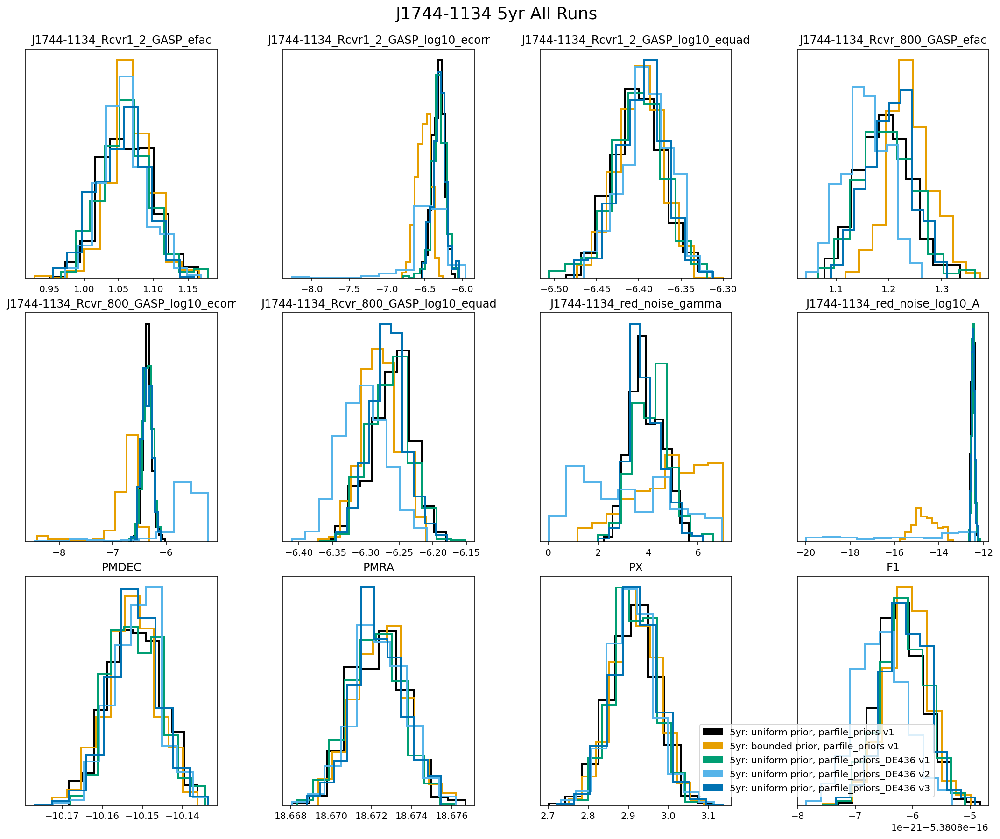

In [46]:
#All Runs
plt_all_rescaled_dataset(rescaled_5yr_core_list_comb,five_yr_chaindirs,'5yr')

In [47]:
white_pars_5yr = []
parfile_priors_pars_5yr = []
for param in rescaled_5yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_5yr.append(param)
        else:
            parfile_priors_pars_5yr.append(param)

White Noise Parameters

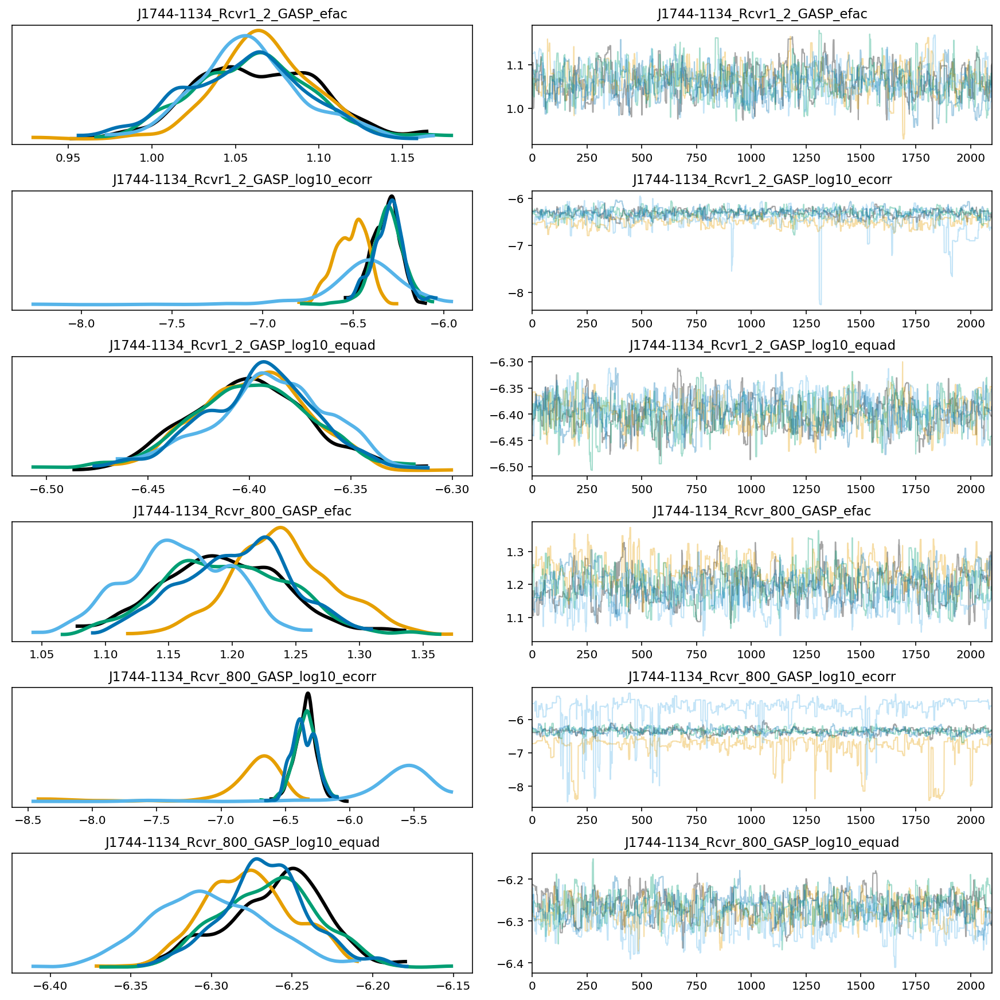

In [48]:
az.plot_trace(az_comb_5yr_rescaled,var_names=white_pars_5yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters

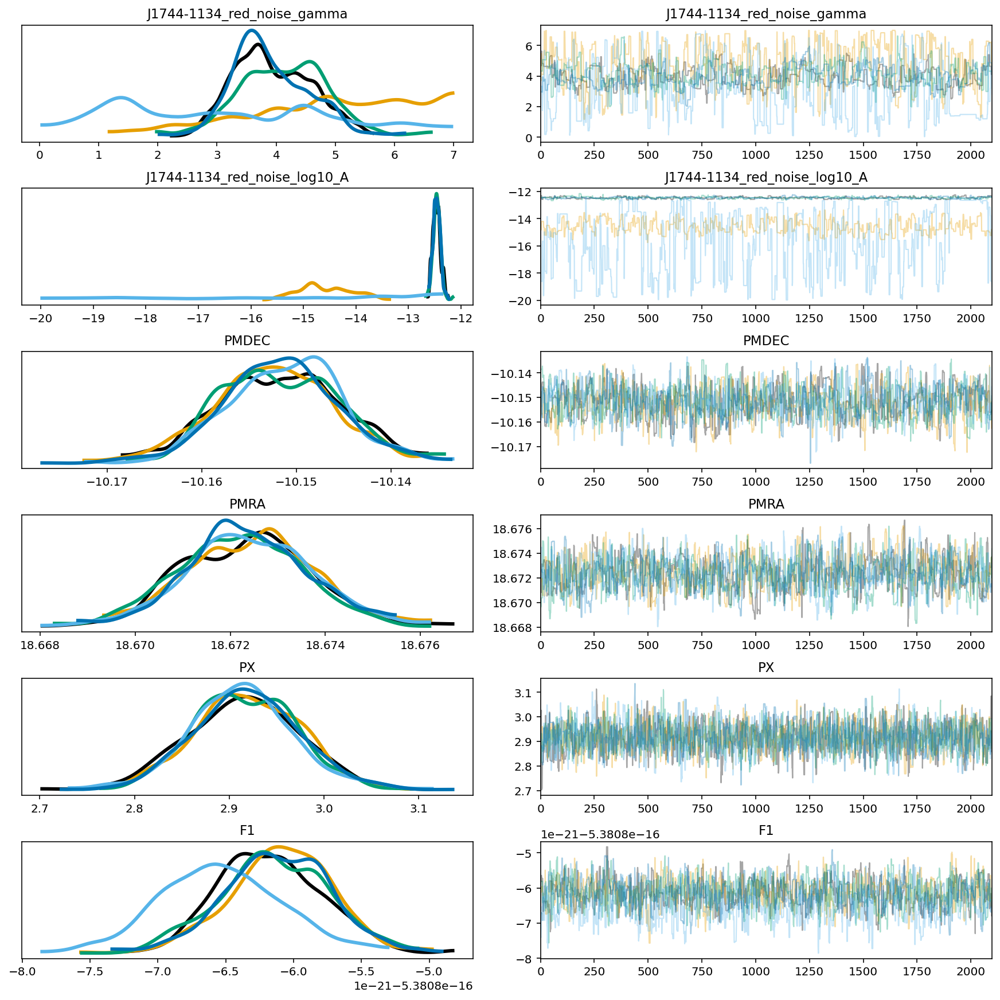

In [49]:
az.plot_trace(az_comb_5yr_rescaled,var_names=parfile_priors_pars_5yr,plot_kwargs={'linewidth':3});

## 9yr Plots

`la_forge` plots, then `arviz`

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


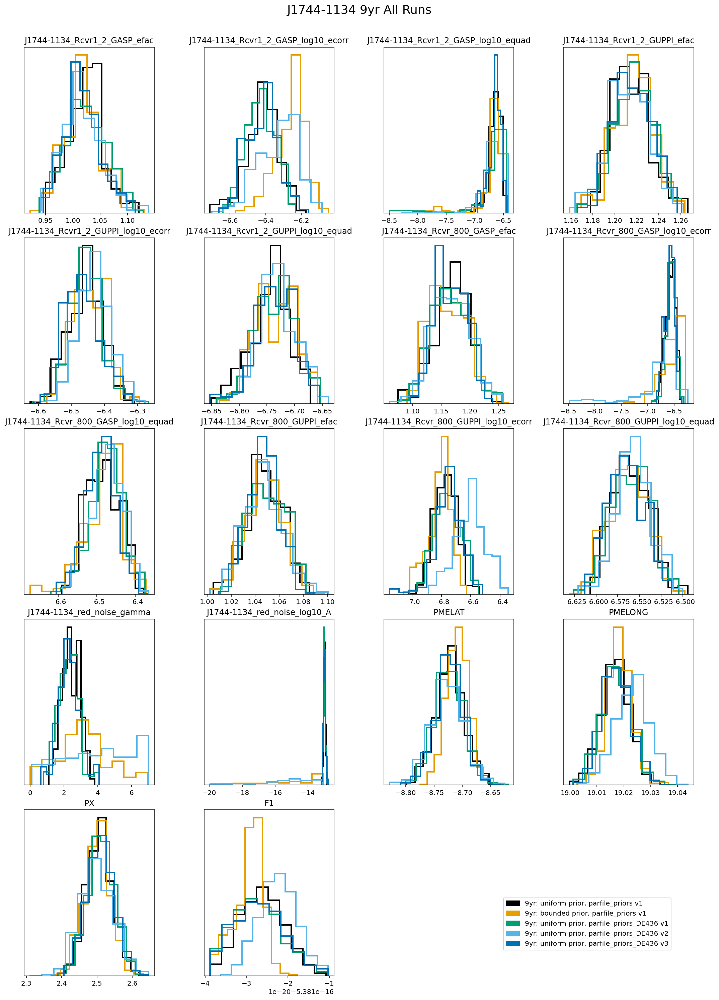

In [50]:
#All Runs
plt_all_rescaled_dataset(rescaled_9yr_core_list_comb,nine_yr_chaindirs,'9yr')

In [51]:
white_pars_9yr = []
parfile_priors_pars_9yr = []
for param in rescaled_9yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_9yr.append(param)
        else:
            parfile_priors_pars_9yr.append(param)

White noise parameters

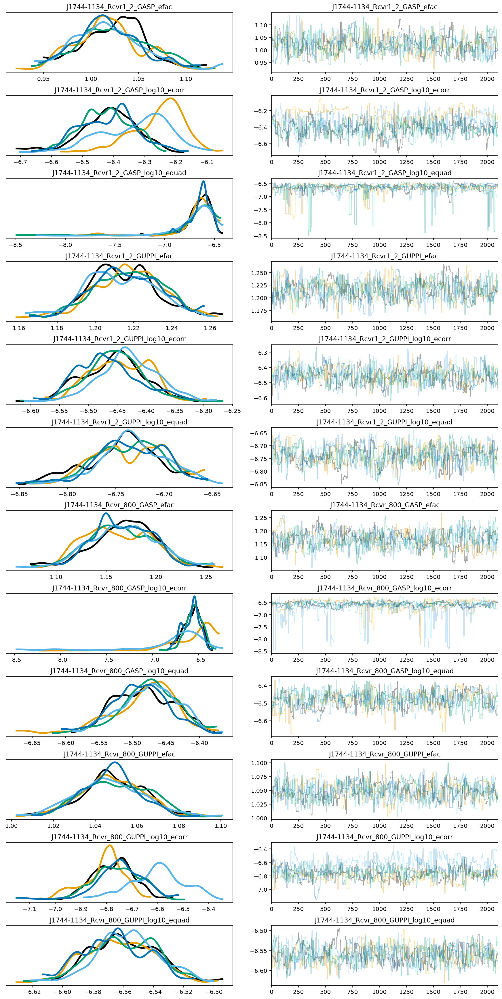

In [52]:
az.plot_trace(az_comb_9yr_rescaled,var_names=white_pars_9yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters


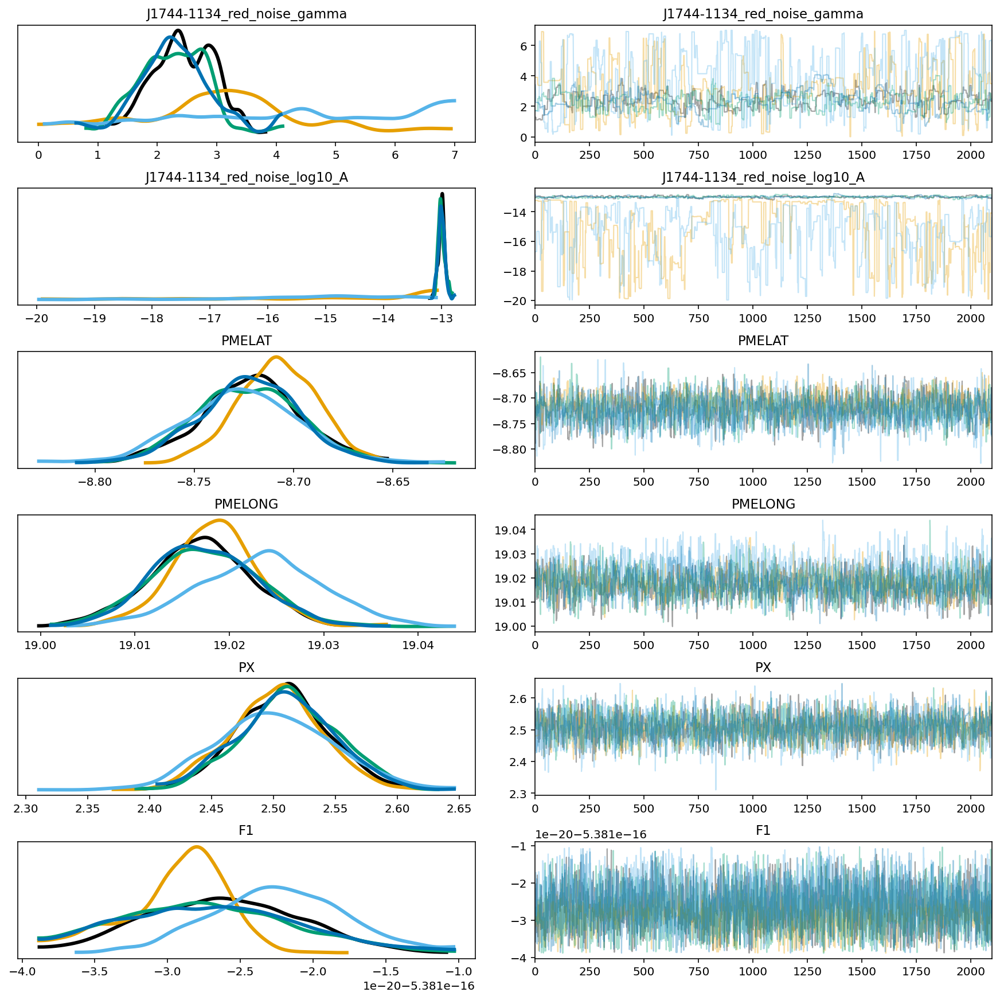

In [53]:
az.plot_trace(az_comb_9yr_rescaled,var_names=parfile_priors_pars_9yr,plot_kwargs={'linewidth':3});

## 11yr Plots

`la_forge` plots, then `arviz`

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


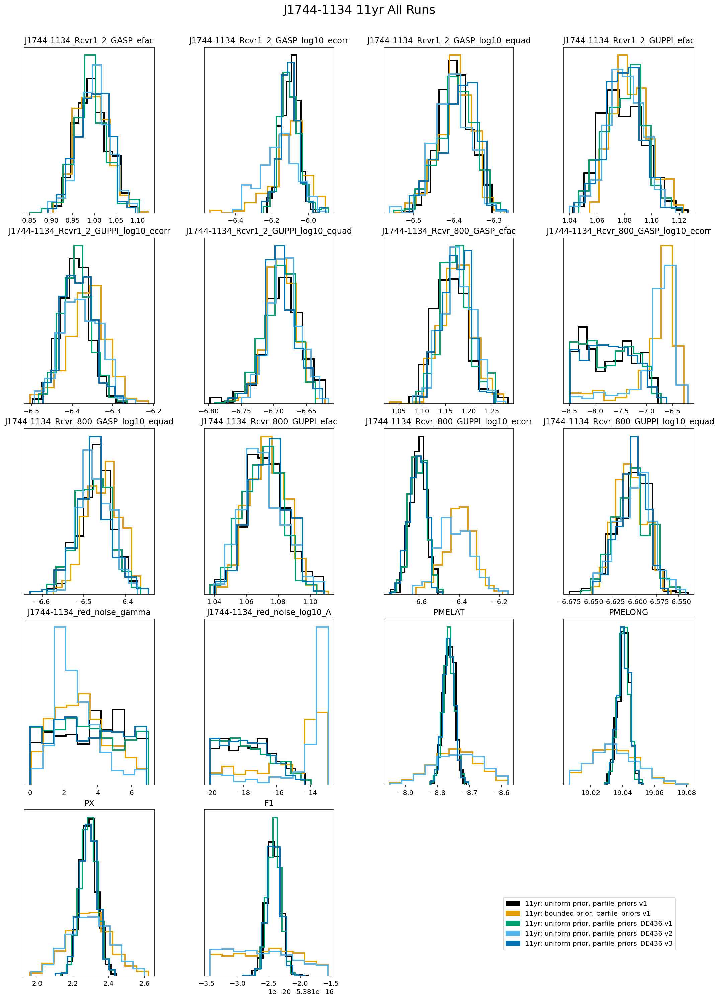

In [54]:
#All Runs
plt_all_rescaled_dataset(rescaled_11yr_core_list_comb,eleven_yr_chaindirs,'11yr')

In [55]:
white_pars_11yr = []
parfile_priors_pars_11yr = []
for param in rescaled_11yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_11yr.append(param)
        else:
            parfile_priors_pars_11yr.append(param)

White noise parameters

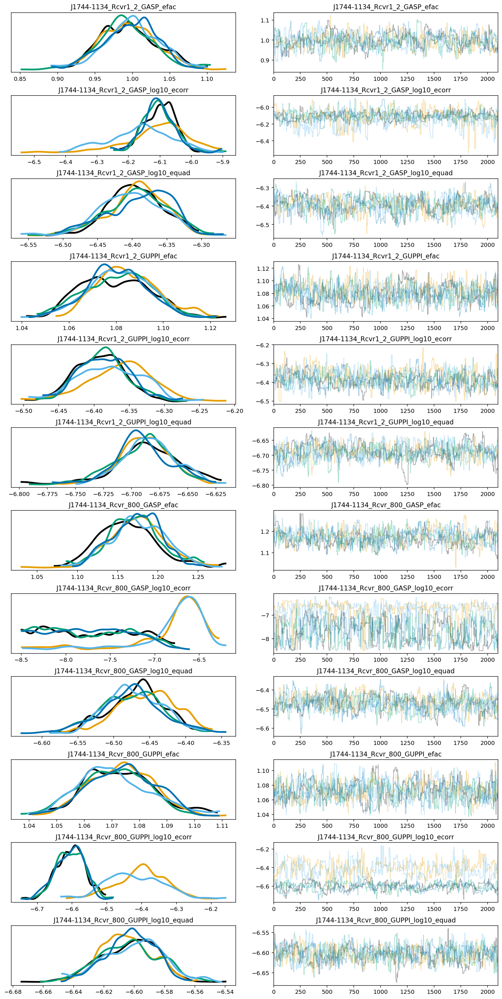

In [56]:
az.plot_trace(az_comb_11yr_rescaled,var_names=white_pars_11yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters

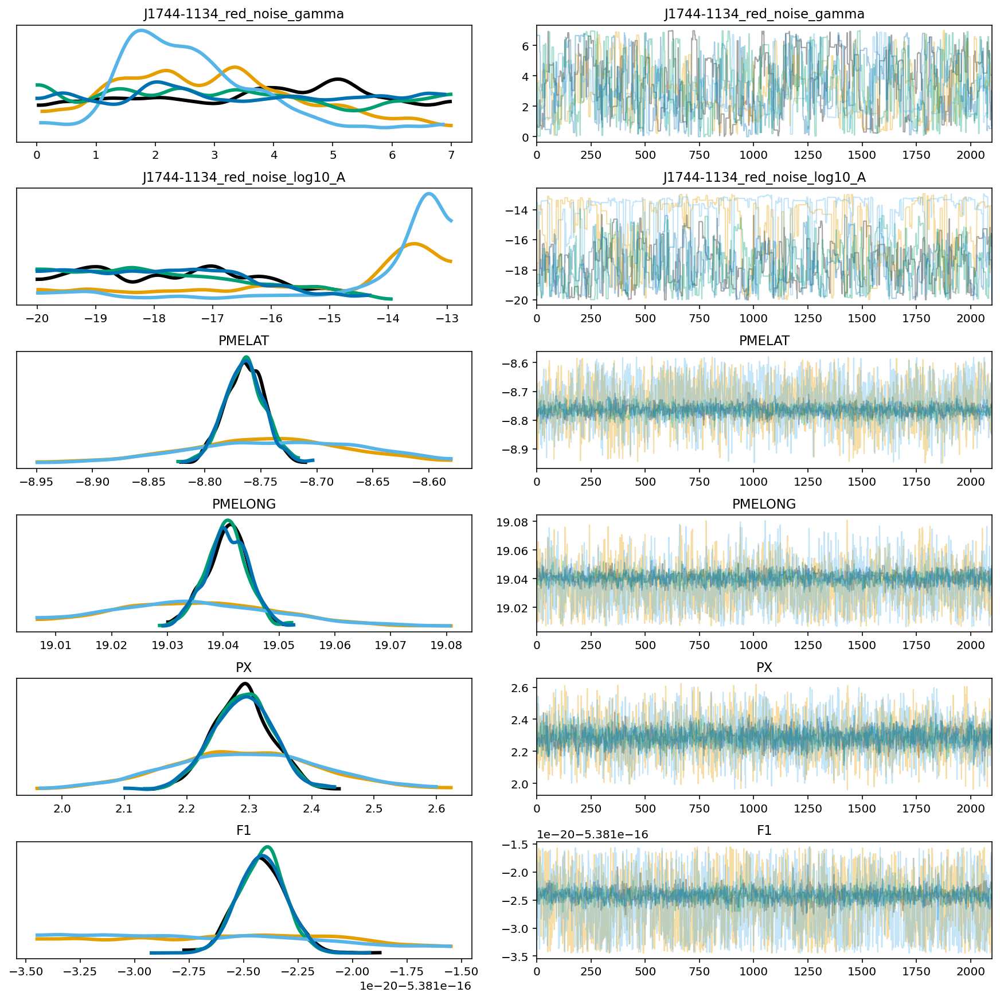

In [57]:
az.plot_trace(az_comb_11yr_rescaled,var_names=parfile_priors_pars_11yr,plot_kwargs={'linewidth':3});

## 12.5yr Plots

`la_forge` plots, then `arviz`

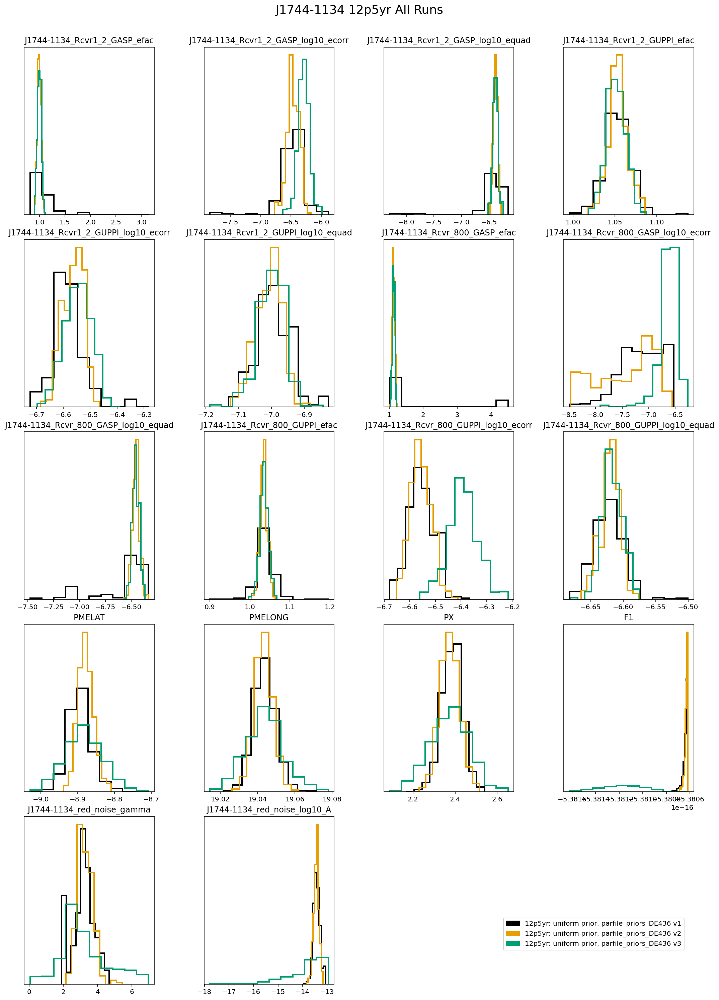

In [58]:
#All Runs
plt_all_rescaled_dataset(rescaled_12p5yr_core_list_comb,twelvep5_yr_chaindirs,'12p5yr')

In [59]:
white_pars_12p5yr = []
parfile_priors_pars_12p5yr = []
for param in rescaled_12p5yr_chain_dict_comb.keys():
    if param not in ['lnlike','lnprior', 'chain accept', 'pt chain accept']:
        if param.split('_')[-1] in ['efac','equad','ecorr']:
            white_pars_12p5yr.append(param)
        else:
            parfile_priors_pars_12p5yr.append(param)

White noise parameters

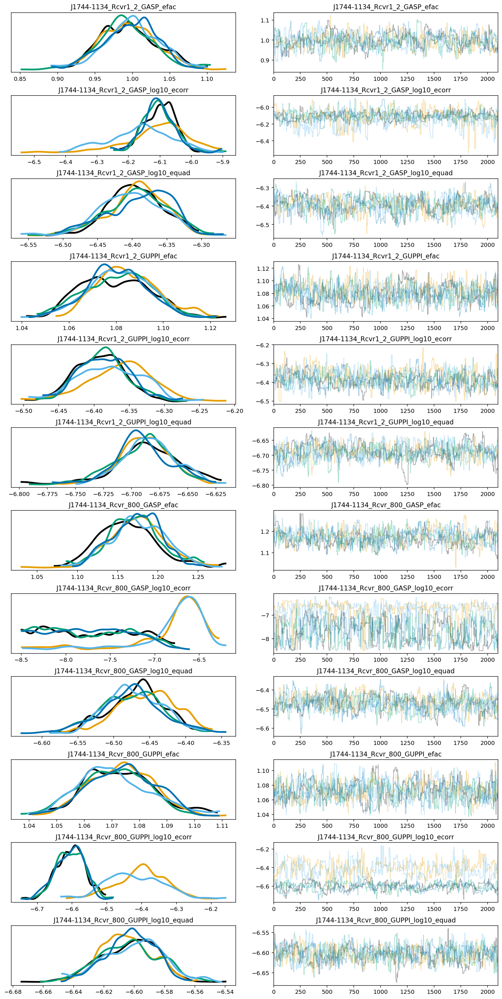

In [60]:
az.plot_trace(az_comb_11yr_rescaled,var_names=white_pars_11yr,plot_kwargs={'linewidth':3});

Red + Timing Parameters

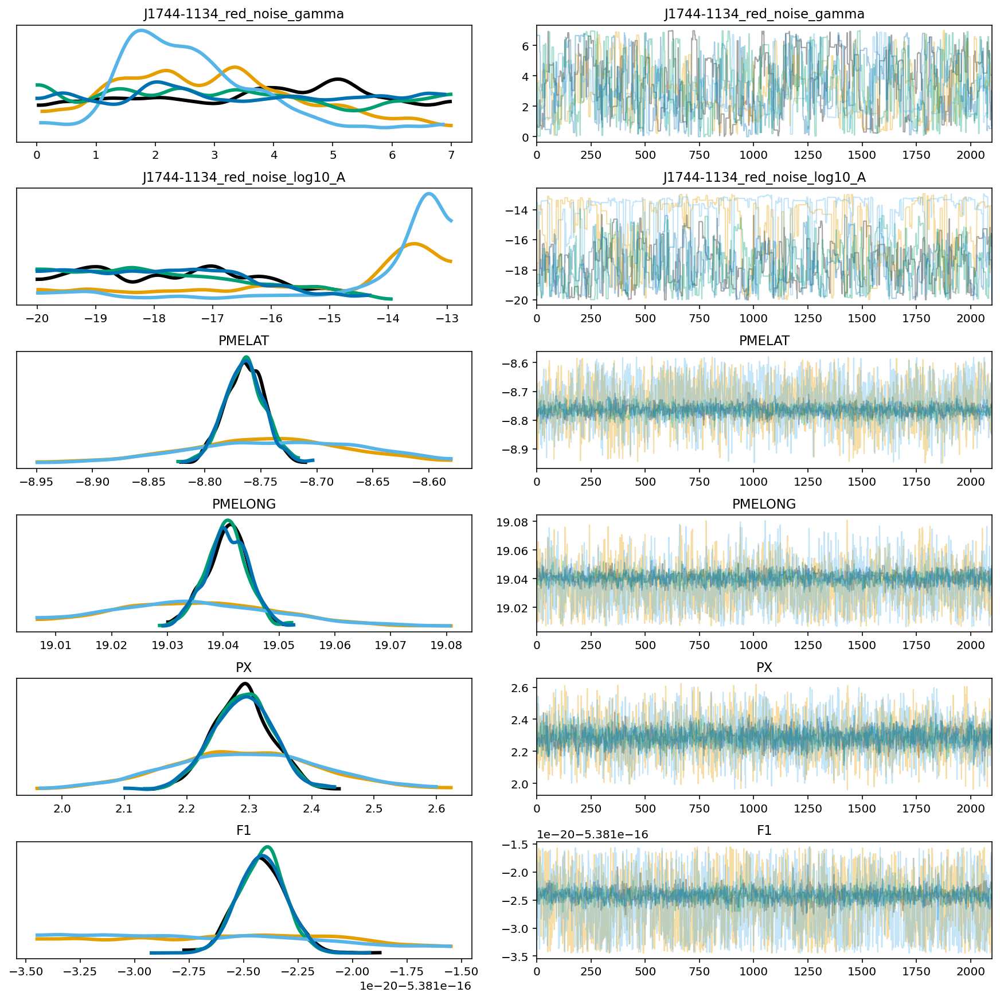

In [61]:
az.plot_trace(az_comb_11yr_rescaled,var_names=parfile_priors_pars_11yr,plot_kwargs={'linewidth':3});

## Combined All Plots

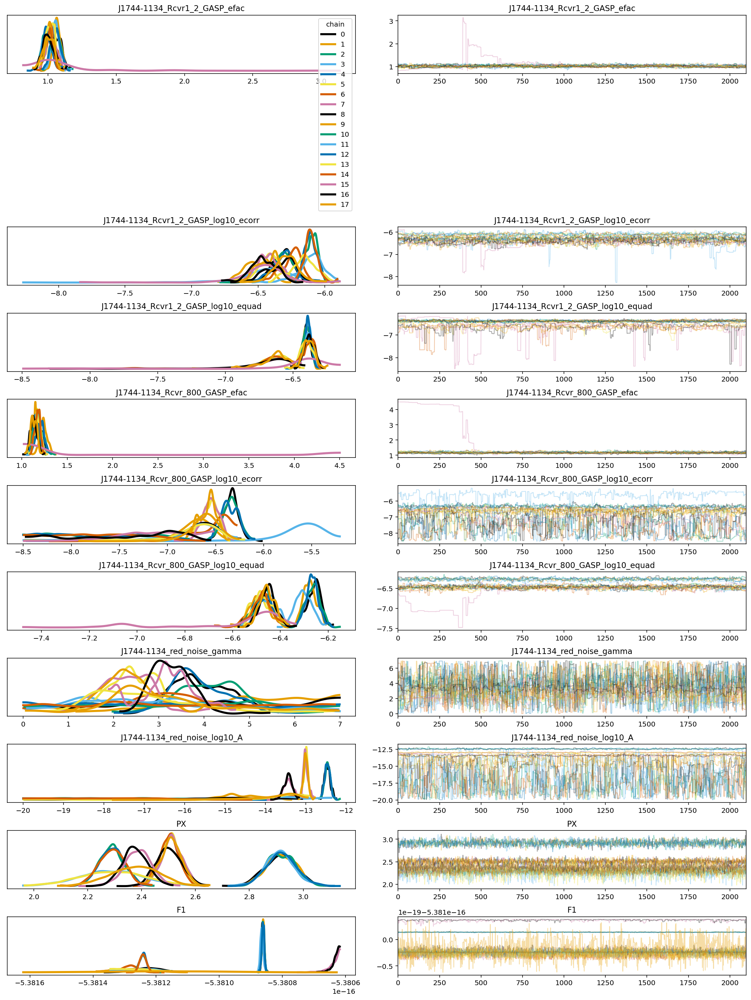

In [62]:
az.plot_trace(rescaled_chain_dict_all,legend=True,figsize=(15,2*len(rescaled_chain_dict_all.keys())),
             plot_kwargs={'linewidth':3});

parfile_priors_DE436 not in bounded dict: dict_keys(['parfile_priors'])


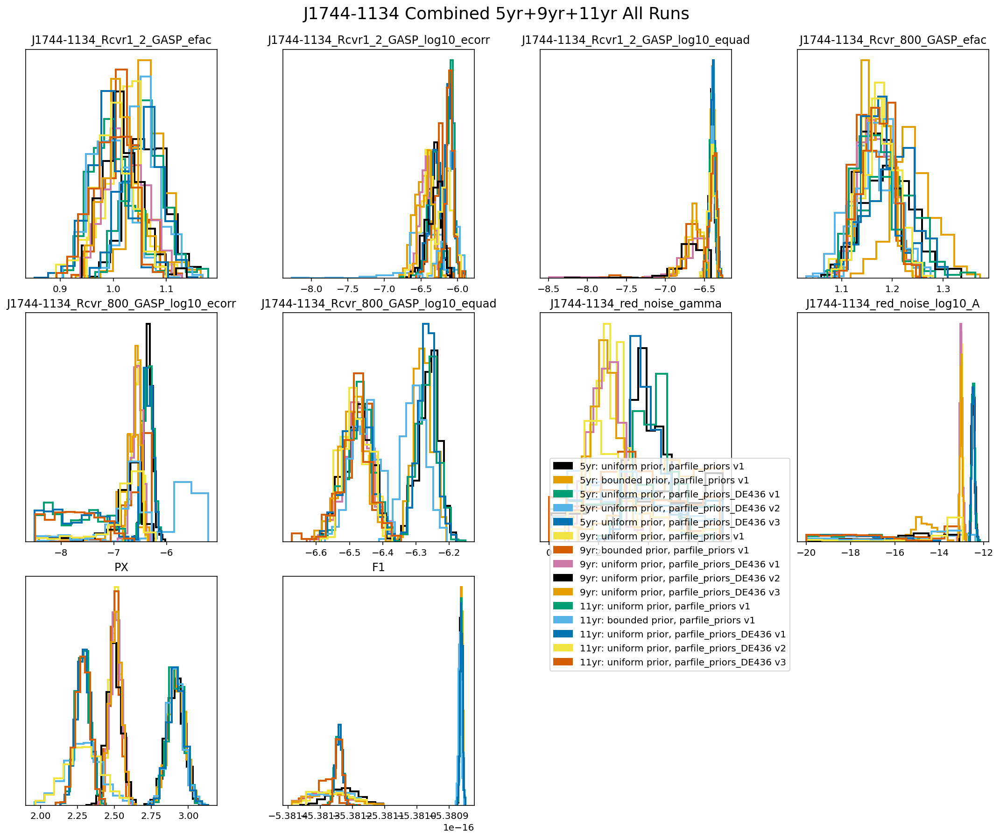

In [63]:
#All Runs
core_kwargs = {'hist':True, 'ncols':4, 'title_y':1.03,
               'suptitle':'{} Combined 5yr+9yr+11yr All Runs'.format(psrlist[0]),
               'bins':10,'hist_kwargs':dict(fill=False),'linewidth':2.}
misc_kwargs = {'legend_on':True,'legend_loc':(.55,.2)}

datasets = ['5yr','9yr','11yr','12p']
priors = []
px_priors = []
for p in chain_dict.keys():
    for px_p in chain_dict[p].keys():
        for dataset in datasets:
            if dataset in chain_dict[p][px_p].keys():
                if p not in priors:
                    priors.append(p)
                if px_p not in px_priors:
                    px_priors.append(px_p)

nltm.plot_common_chains((rescaled_5yr_core_list_comb + rescaled_9yr_core_list_comb + \
                         rescaled_11yr_core_list_comb + rescaled_12p5yr_core_list_comb),
                        (five_yr_chaindirs+nine_yr_chaindirs+eleven_yr_chaindirs+twelvep5_yr_chaindirs),
                        priors,px_priors,datasets,
                        plot_kwargs=core_kwargs,misc_kwargs=misc_kwargs)

# PX Only

In [64]:
tmp = rescaled_5yr_core_list_comb + rescaled_9yr_core_list_comb +\
rescaled_11yr_core_list_comb + rescaled_12p5yr_core_list_comb
px_array = []
for tmp_core in tmp:
    px_array.append(tmp_core.get_param('PX',to_burn=False))

In [65]:
mus = []
lb = []
ub = []
for dataset in pardict.keys():
    for parvals in pardict[dataset].values():
        mus.append(parvals['PX']['val'])
        lb.append(parvals['PX']['val']-parvals['PX']['val']*parvals['PX']['err'])
        ub.append(parvals['PX']['val']+parvals['PX']['val']*parvals['PX']['err'])

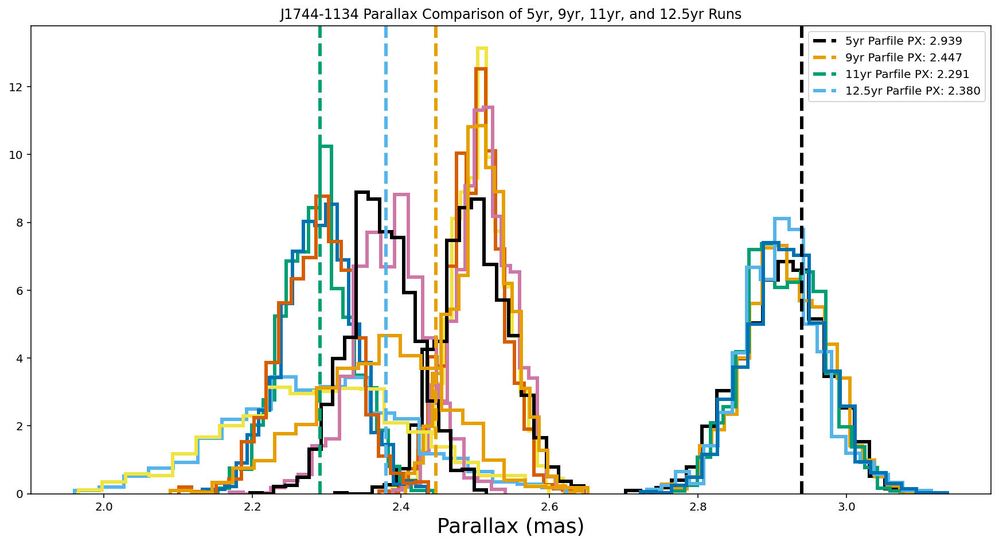

In [66]:
fig,ax = plt.subplots(1,1,figsize=(15,7.5))
hist_kwargs = {'fill':False,'bins':20,'linewidth':3.,'density':True,'histtype':'step'}
legend_list = ['5yr: Uniform, Parfile Priors','5yr: Bounded Normal, Parfile Priors',
               '9yr: Uniform, Parfile Priors','9yr: Bounded Normal, Parfile Priors',
               '11yr: Uniform, Parfile Priors','11yr: Bounded Normal, Parfile Priors']

for i,px in enumerate(px_array):
    hist_kwargs['Color'] = 'C{}'.format(i)
    #hist_kwargs['label'] = legend_list[i]
    ax.hist(px,**hist_kwargs);

legend_list_2 = ['5yr Parfile PX','9yr Parfile PX','11yr Parfile PX','12.5yr Parfile PX']
for i,mu in enumerate(mus):
    ax.axvline(x=mu,linestyle='--',linewidth=3,color='C{}'.format(i),label=legend_list_2[i]+': %.3f' %mu)
ax.set_xlabel(r'Parallax (mas)',fontsize=18)
plt.title('{} Parallax Comparison of 5yr, 9yr, 11yr, and 12.5yr Runs'.format(psrlist[0]))
plt.legend()#loc=(.48,.7))
#plt.savefig('./Figures/{}_px_comp.png'.format(psrlist[0]),dpi=300,bbox_inches='tight')
plt.show()